In [1]:
import sys
sys.path.append("../")

import os
import cv2
import copy
import numpy as np
import pandas as pd
import seaborn as sns
import albumentations as A
import matplotlib.pyplot as plt

from utils.plot_util import visualize_class_distribution, visualize_class_images

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.12 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


# 데이터 로드

In [2]:
data_path = "../dataset"
image_path = f"{data_path}/train"

train_df = pd.read_csv(f"{data_path}/train.csv")
meta_df = pd.read_csv(f"{data_path}/meta.csv")

In [3]:
display(train_df.shape)
display(train_df.head())

(1570, 2)

,ID,target
0,002f99746285dfdd.jpg,16
1,008ccd231e1fea5d.jpg,10
2,008f5911bfda7695.jpg,10
3,009235e4c9c07af5.jpg,4
4,00b2f44967580c74.jpg,16


In [5]:
display(meta_df.shape)
display(meta_df['class_name'].unique())

(17, 2)

array(['account_number',
       'application_for_payment_of_pregnancy_medical_expenses',
       'car_dashboard', 'confirmation_of_admission_and_discharge',
       'diagnosis', 'driver_lisence', 'medical_bill_receipts',
       'medical_outpatient_certificate', 'national_id_card', 'passport',
       'payment_confirmation', 'pharmaceutical_receipt', 'prescription',
       'resume', 'statement_of_opinion',
       'vehicle_registration_certificate', 'vehicle_registration_plate'],
      dtype=object)

# 데이터 구성 시각화

In [6]:
plot_path = "../plots"
os.makedirs(plot_path, exist_ok=True)

- vehicle_registration_plate : 차량 등록 번호판
- payment_confirmation : 결제 확인서
- diagnosis : 진단서
- driver_lisence : 운전 면허증
- vehicle_registration_certificate : 차량 등록 증명서
- passport : 여권
- medical_outpatient_certificate : 외래 진료 증명서
- car_dashboard : 자동차 대시보드
- pharmaceutical_receipt : 약국 영수증
- confirmation_of_admission_and_discharge : 입퇴원 확인서
- account_number : 계좌 번호
- national_id_card : 국가 신분증
- prescription : 처방전
- medical_bill_receipts : 의료비 영수증
- resume : 이력서
- statement_of_opinion : 의견 진술서
- application_for_payment_of_pregnancy_medical_expenses : 임신 의료비 지급 신청서

/home/pervinco/upstage-cv-classification-cv7/notebook/../utils/plot_util.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y='class_name', x='file_count', data=class_counts, palette='viridis')


Plot saved as ../plots/total_class_dist.png
                                           class_name  file_count
0                          vehicle_registration_plate         100
1                                payment_confirmation         100
2                                           diagnosis         100
3                                      driver_lisence         100
4                    vehicle_registration_certificate         100
5                                            passport         100
6                      medical_outpatient_certificate         100
7                                       car_dashboard         100
8                              pharmaceutical_receipt         100
9             confirmation_of_admission_and_discharge         100
10                                     account_number         100
11                                   national_id_card         100
12                                       prescription         100
13                              

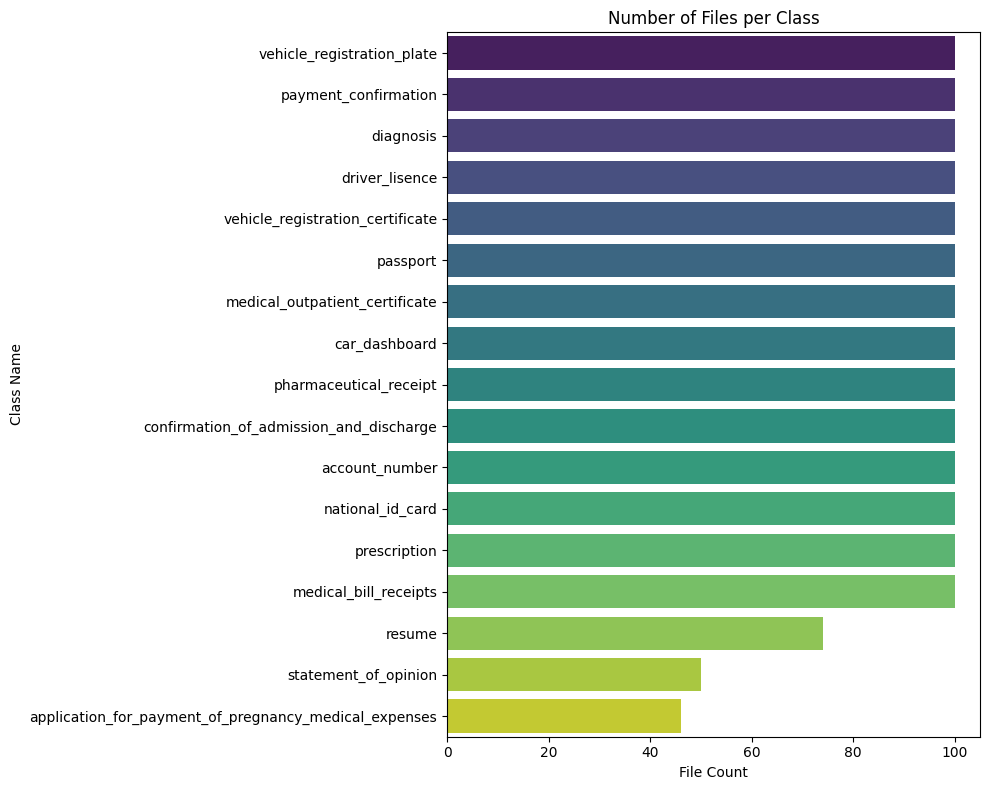

In [7]:
class_counts = visualize_class_distribution(train_df, meta_df, save_plot=True, plot_path=f"{plot_path}/total_class_dist.png")
print(class_counts)

Plot saved as ../plots/sample_vehicle_registration_plate.png
Plot saved as ../plots/sample_payment_confirmation.png
Plot saved as ../plots/sample_diagnosis.png
Plot saved as ../plots/sample_driver_lisence.png
Plot saved as ../plots/sample_vehicle_registration_certificate.png
Plot saved as ../plots/sample_statement_of_opinion.png
Plot saved as ../plots/sample_passport.png
Plot saved as ../plots/sample_resume.png
Plot saved as ../plots/sample_medical_outpatient_certificate.png
Plot saved as ../plots/sample_pharmaceutical_receipt.png
Plot saved as ../plots/sample_car_dashboard.png
Plot saved as ../plots/sample_national_id_card.png
Plot saved as ../plots/sample_prescription.png
Plot saved as ../plots/sample_confirmation_of_admission_and_discharge.png
Plot saved as ../plots/sample_account_number.png
Plot saved as ../plots/sample_application_for_payment_of_pregnancy_medical_expenses.png
Plot saved as ../plots/sample_medical_bill_receipts.png


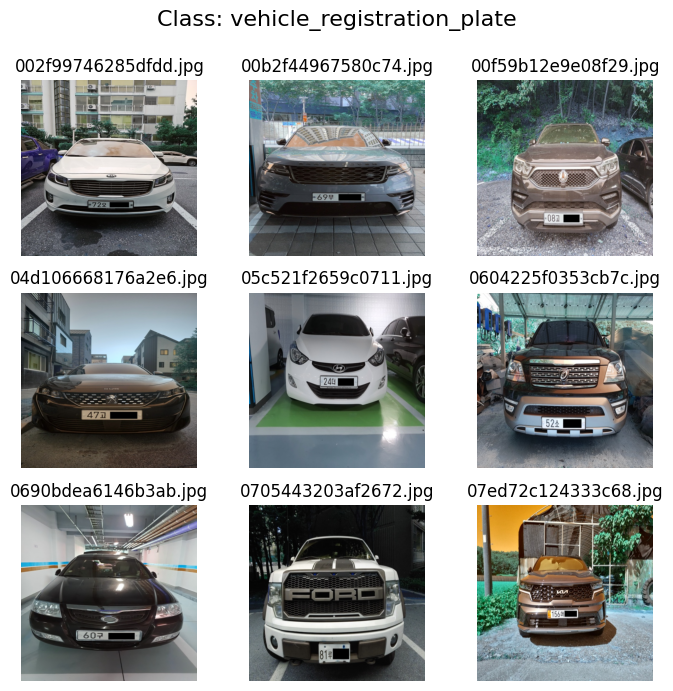

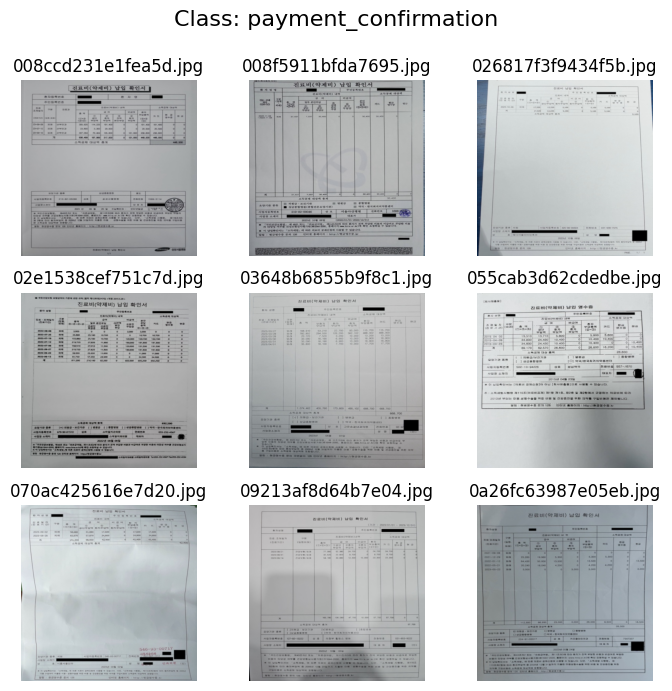

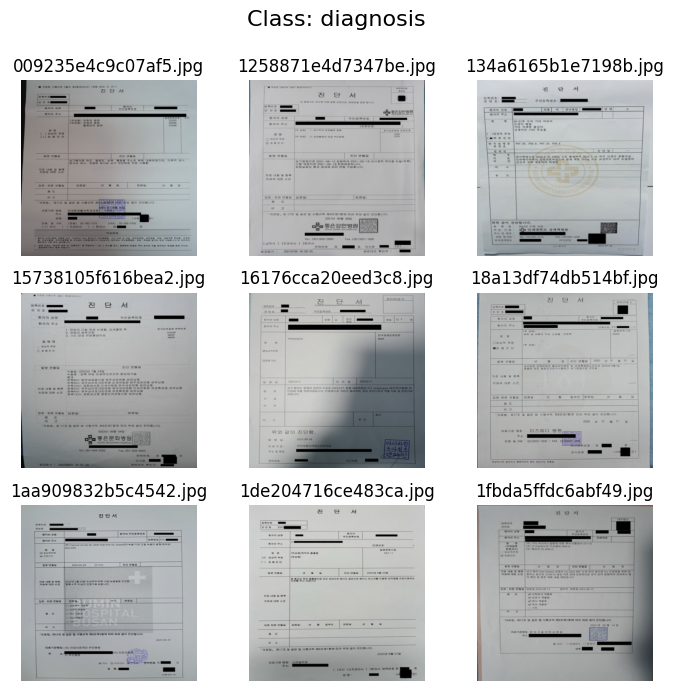

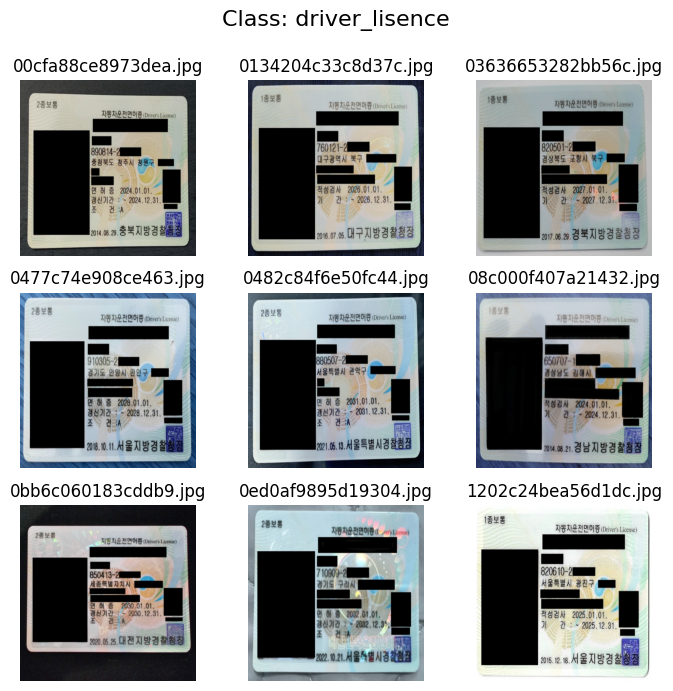

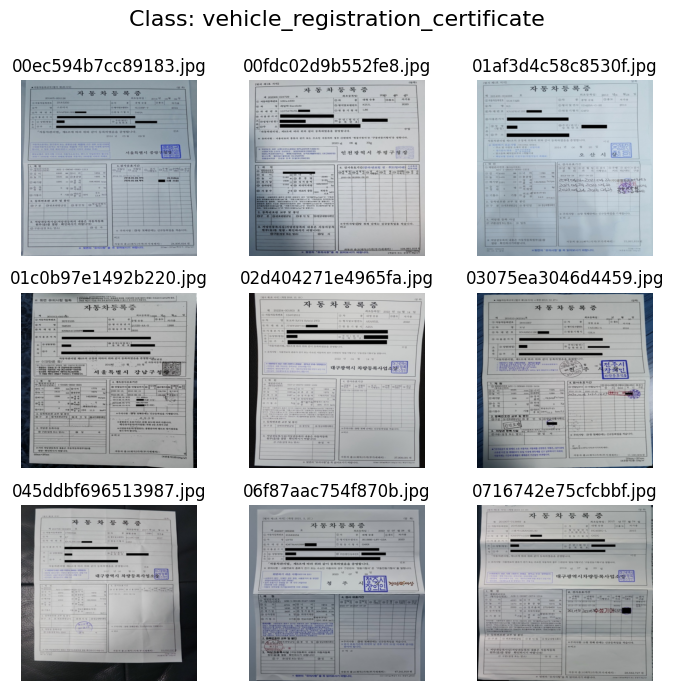

...

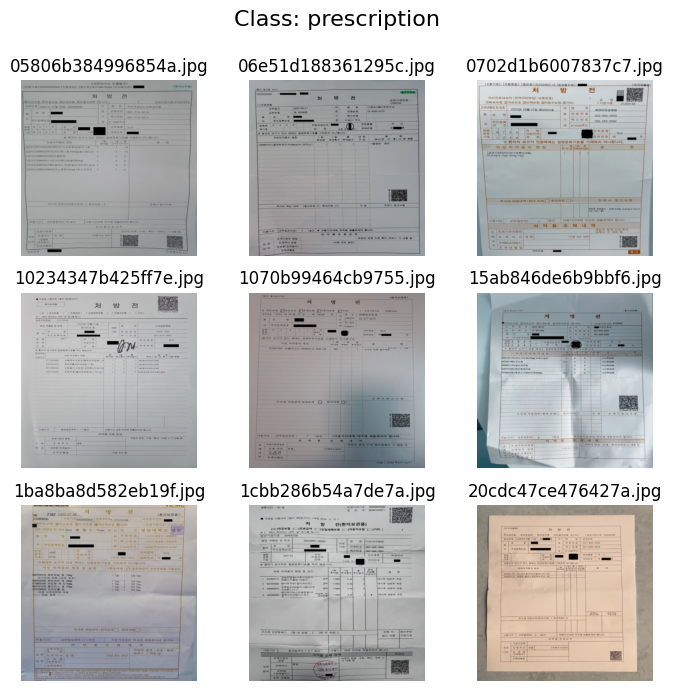

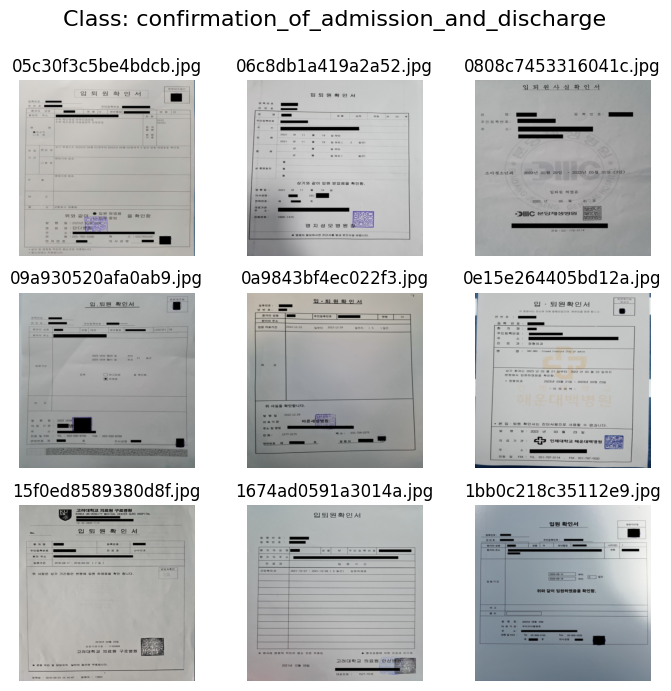

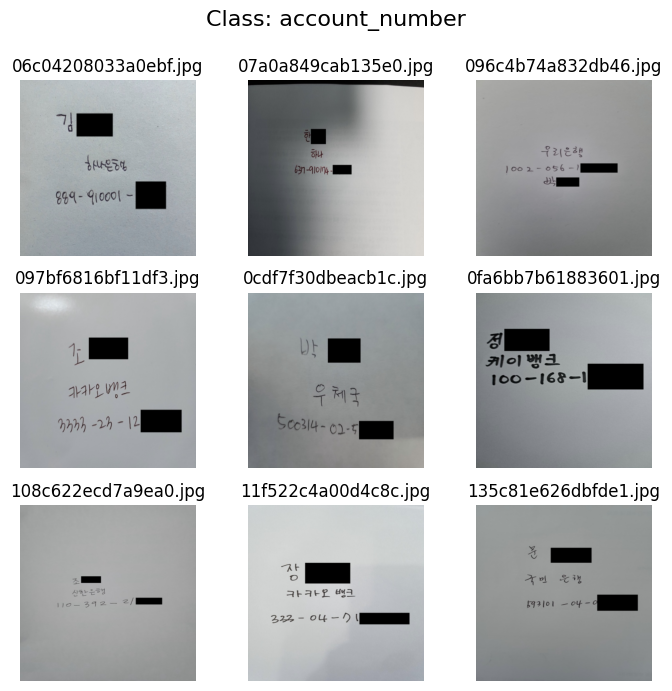

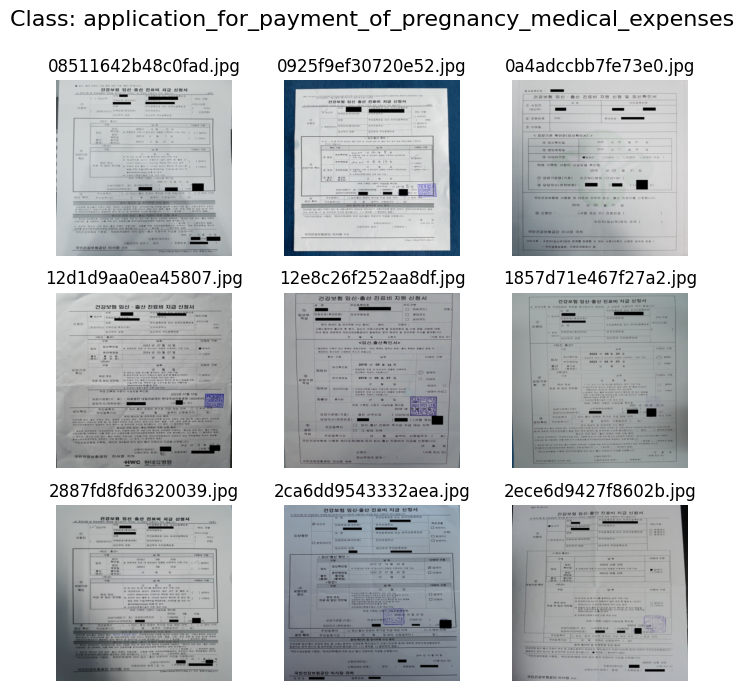

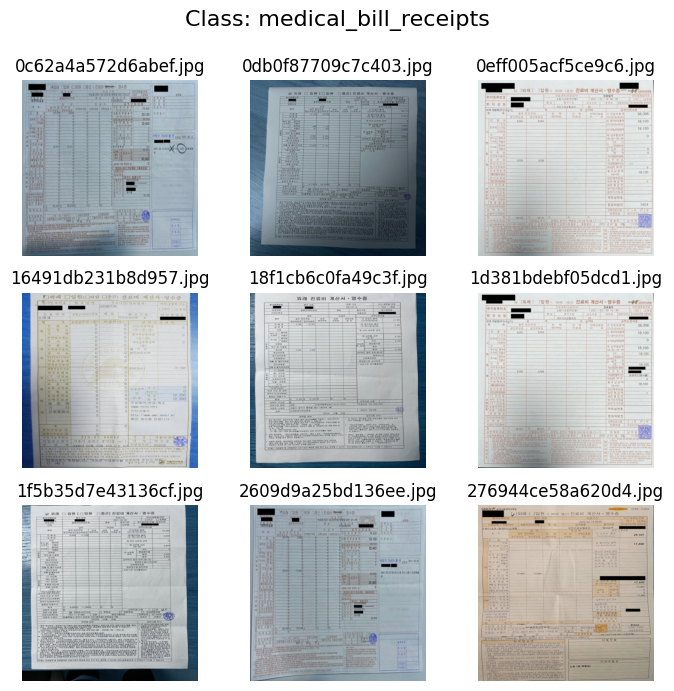

In [8]:
visualize_class_images(train_df, meta_df, data_path=f"{data_path}/train", save_plot=True, plot_path=f"{plot_path}/sample.png")

# 이미지 크기 확인

In [9]:
heights, widths = [], []
for i, row in train_df.iterrows():
    id, target = row['ID'], row['target']

    image = cv2.imread(f"{data_path}/train/{id}")
    height, width, _ = image.shape

    heights.append(height)
    widths.append(width)

train_df['height'] = heights
train_df['width'] = widths

In [10]:
display(train_df.head())

,ID,target,class_name,height,width
0,002f99746285dfdd.jpg,16,vehicle_registration_plate,591,443
1,008ccd231e1fea5d.jpg,10,payment_confirmation,591,443
2,008f5911bfda7695.jpg,10,payment_confirmation,591,443
3,009235e4c9c07af5.jpg,4,diagnosis,591,443
4,00b2f44967580c74.jpg,16,vehicle_registration_plate,591,443


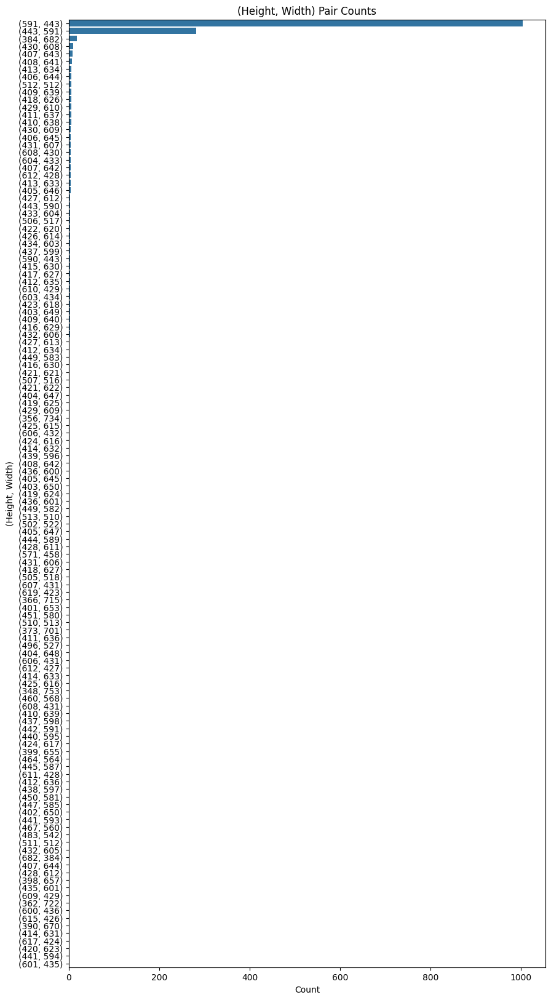

In [11]:
train_df['height_width'] = list(zip(train_df['height'], train_df['width']))
pair_counts = train_df['height_width'].value_counts()

pair_counts_df = pair_counts.reset_index()
pair_counts_df.columns = ['(height, width)', 'count']
pair_counts_df['(height, width)'] = pair_counts_df['(height, width)'].apply(lambda x: f"({x[0]}, {x[1]})")

plt.figure(figsize=(10, 20))
sns.barplot(data=pair_counts_df, x='count', y='(height, width)')
plt.title('(Height, Width) Pair Counts')
plt.xlabel('Count')
plt.ylabel('(Height, Width)')
plt.show()

In [12]:
## height / width로 비율 계산
train_df['ratio'] = train_df['height'] / train_df['width']

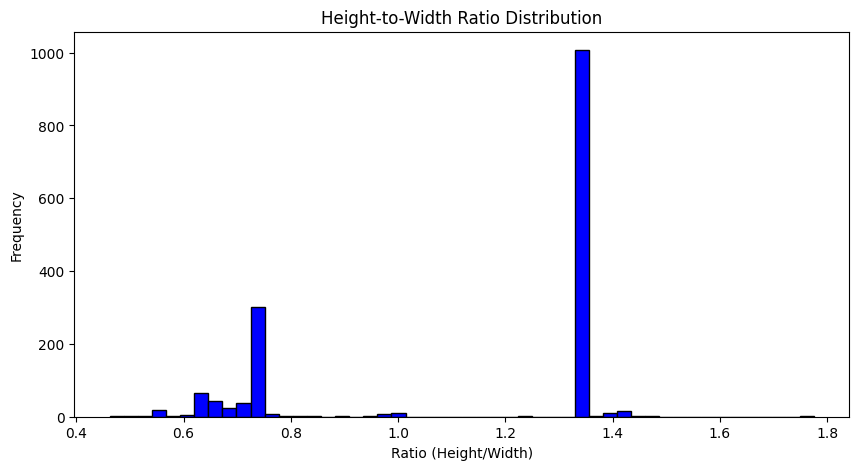

In [13]:
plt.figure(figsize=(10, 5))
plt.hist(train_df['ratio'], bins=50, color='blue', edgecolor='black')
plt.title('Height-to-Width Ratio Distribution')
plt.xlabel('Ratio (Height/Width)')
plt.ylabel('Frequency')
plt.show()

In [19]:
## 후보 1.평균값
mean_height = train_df['height'].mean()
mean_width = train_df['width'].mean()

resize_height = int(mean_height)
resize_width = int(mean_width)

print(f"평균 크기: ({resize_height}, {resize_width})")
print(f"비율 : {resize_height / resize_width}")

평균 크기: (538, 497)
비율 : 1.0824949698189135


In [20]:
## 후보 2.중앙값
median_height = int(train_df['height'].median())
median_width = int(train_df['width'].median())

print(f"중앙값 크기: ({median_height}, {median_width})")
print(f"비율 : {resize_height / resize_width}")

중앙값 크기: (591, 443)
비율 : 1.0824949698189135


In [21]:
## 후보 3.백분위수
percentile_90_height = int(train_df['height'].quantile(0.90))
percentile_90_width = int(train_df['width'].quantile(0.90))

print(f"90번째 백분위수 크기: ({percentile_90_height}, {percentile_90_width})")
print(f"비율 : {resize_height / resize_width}")

90번째 백분위수 크기: (591, 613)
비율 : 1.0824949698189135


In [22]:
## 후보 4.최빈값
common_height = train_df['height'].mode()[0]
common_width = train_df['width'].mode()[0]

print(f"최빈값 크기: ({common_height}, {common_width})")
print(f"비율 : {resize_height / resize_width}")

최빈값 크기: (591, 443)
비율 : 1.0824949698189135


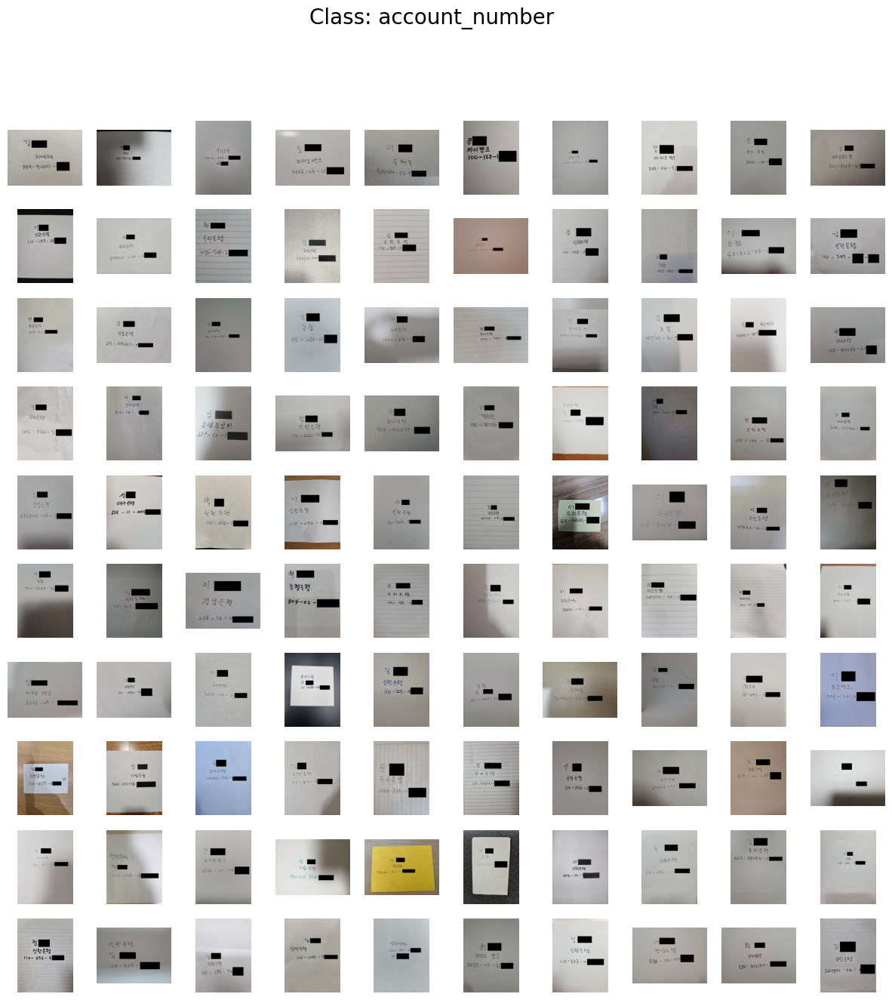

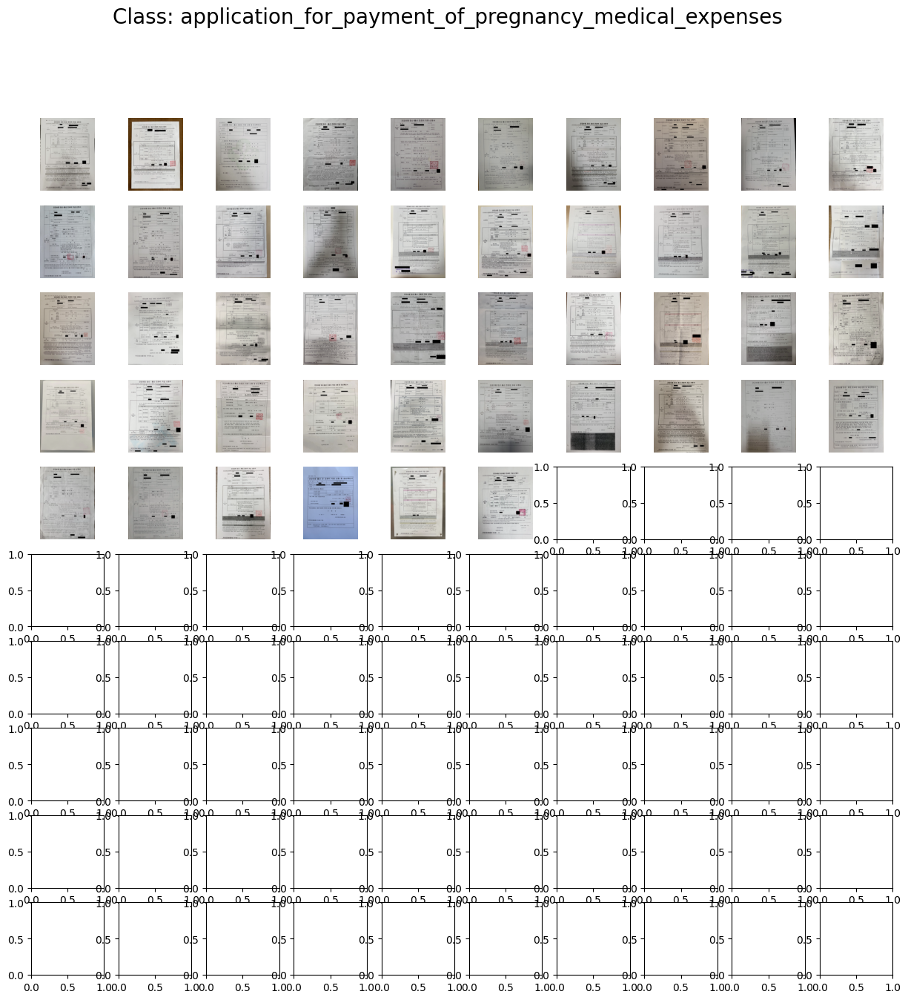

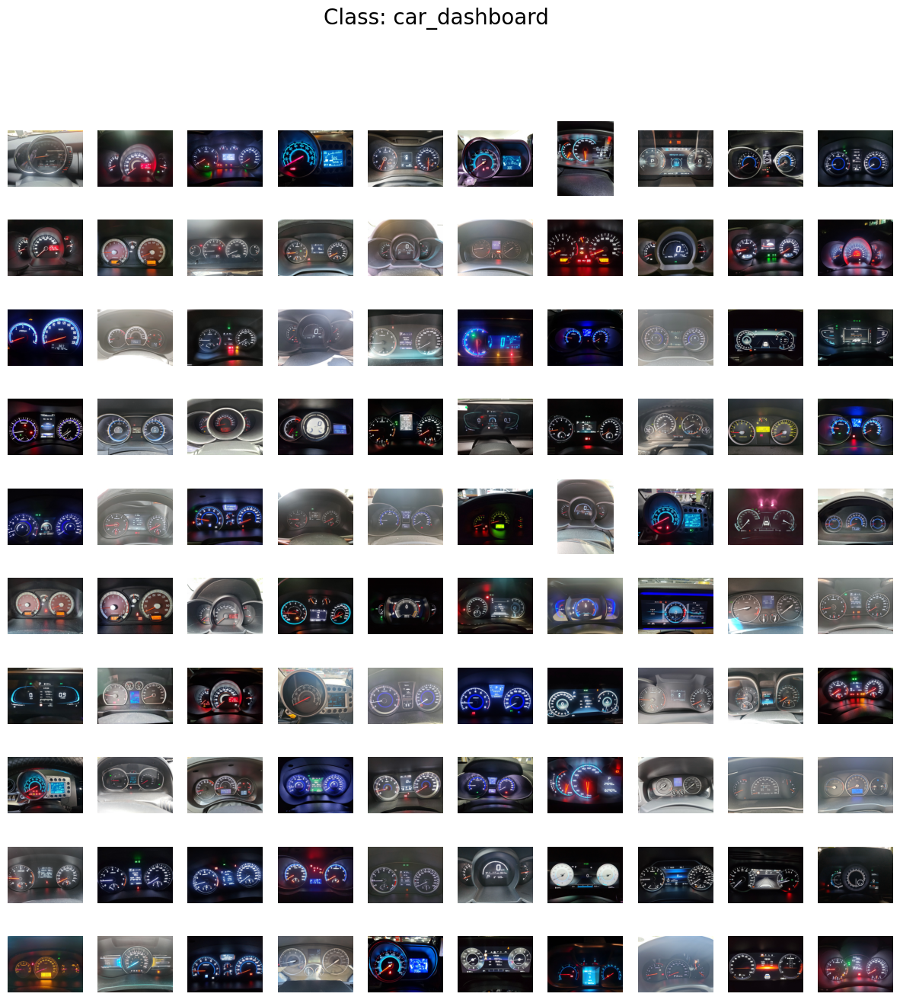

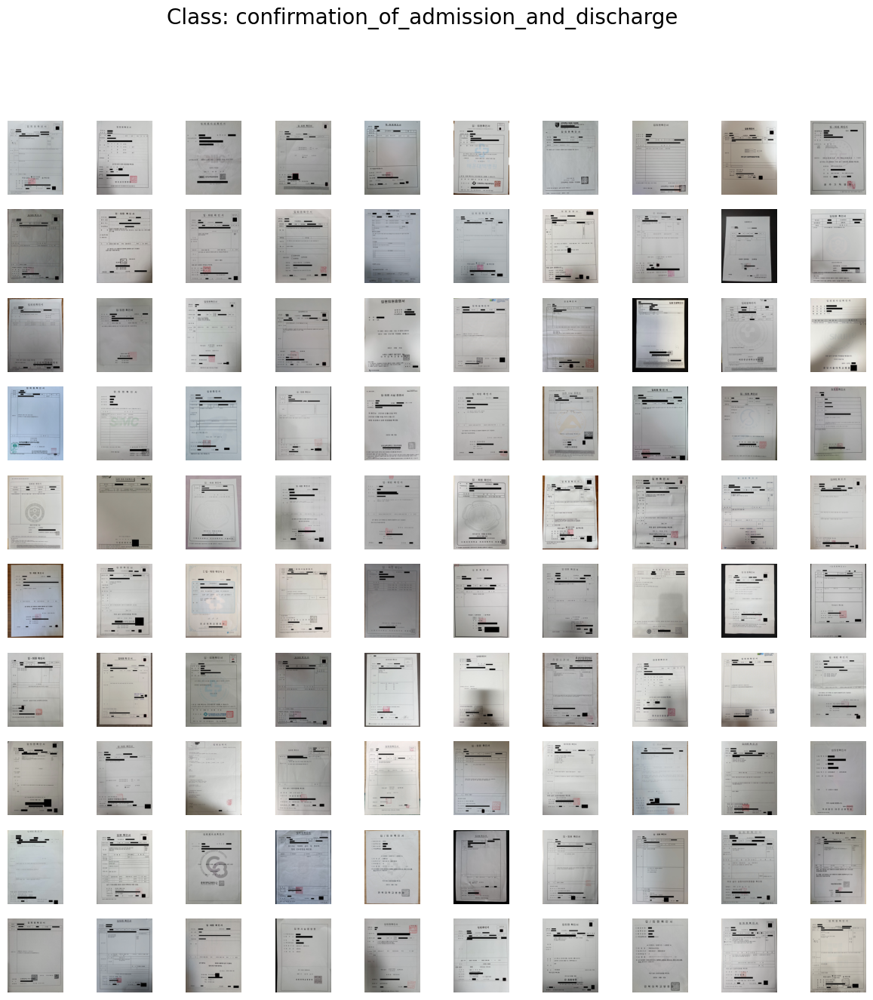

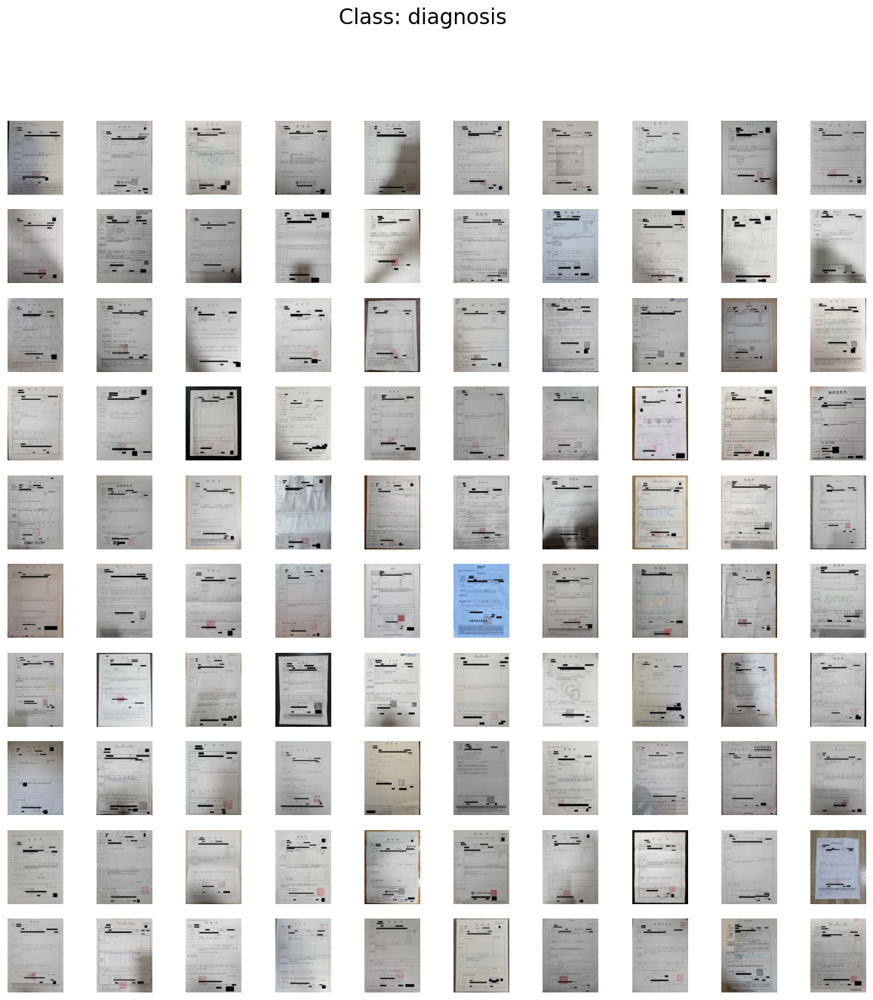

...

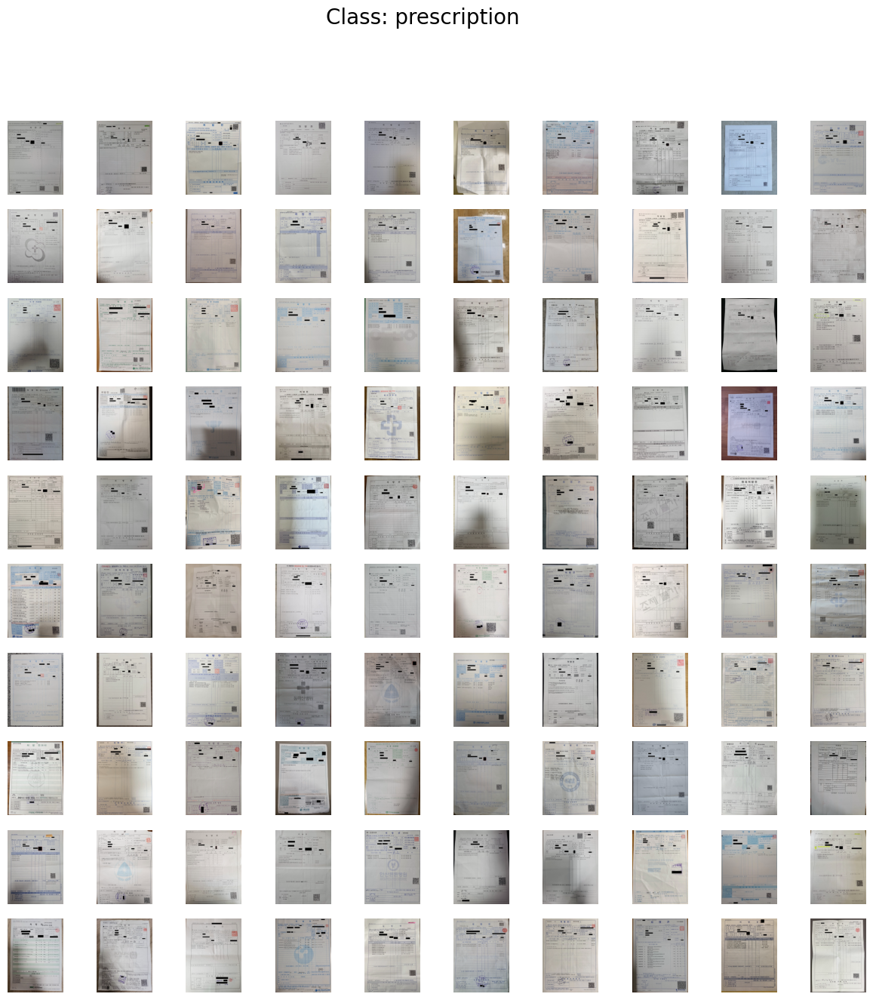

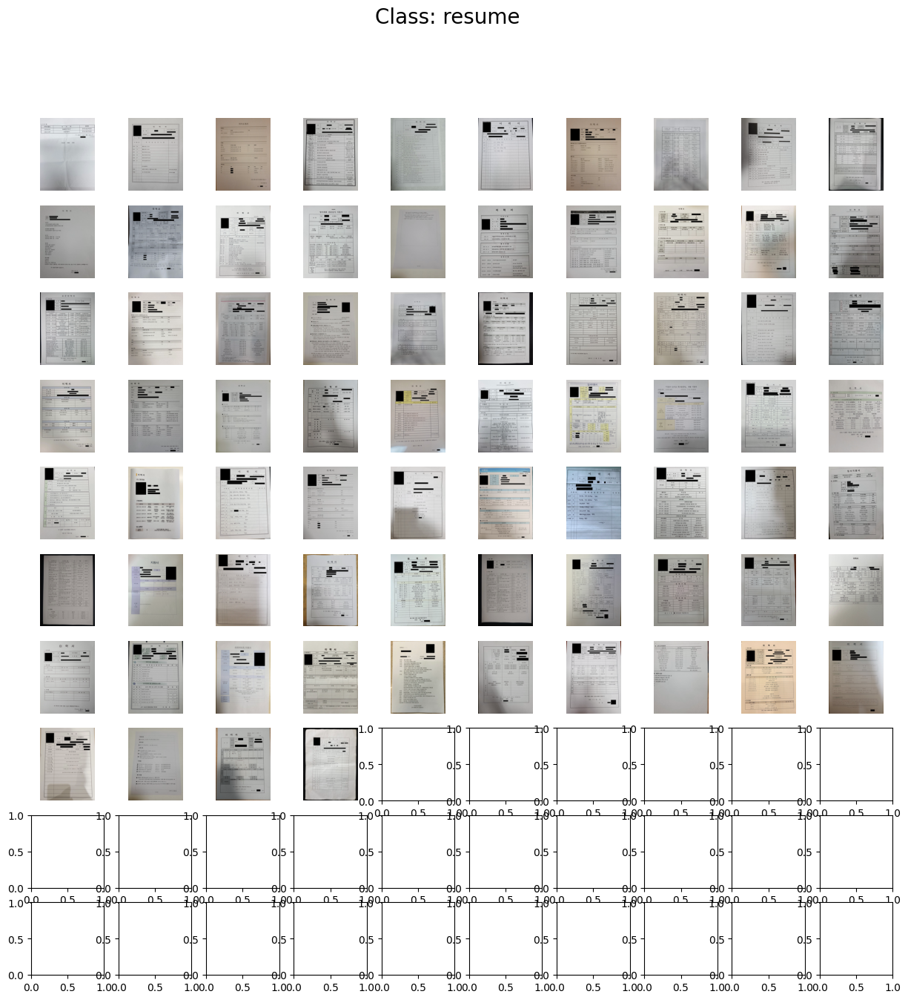

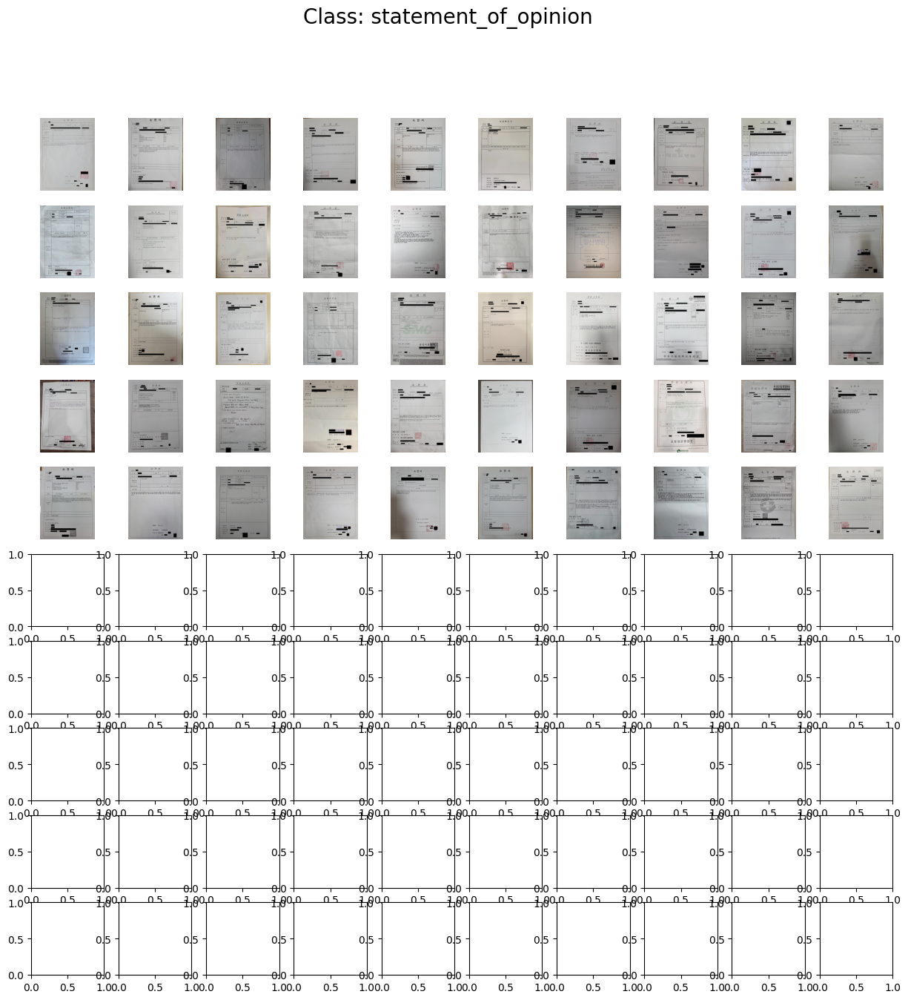

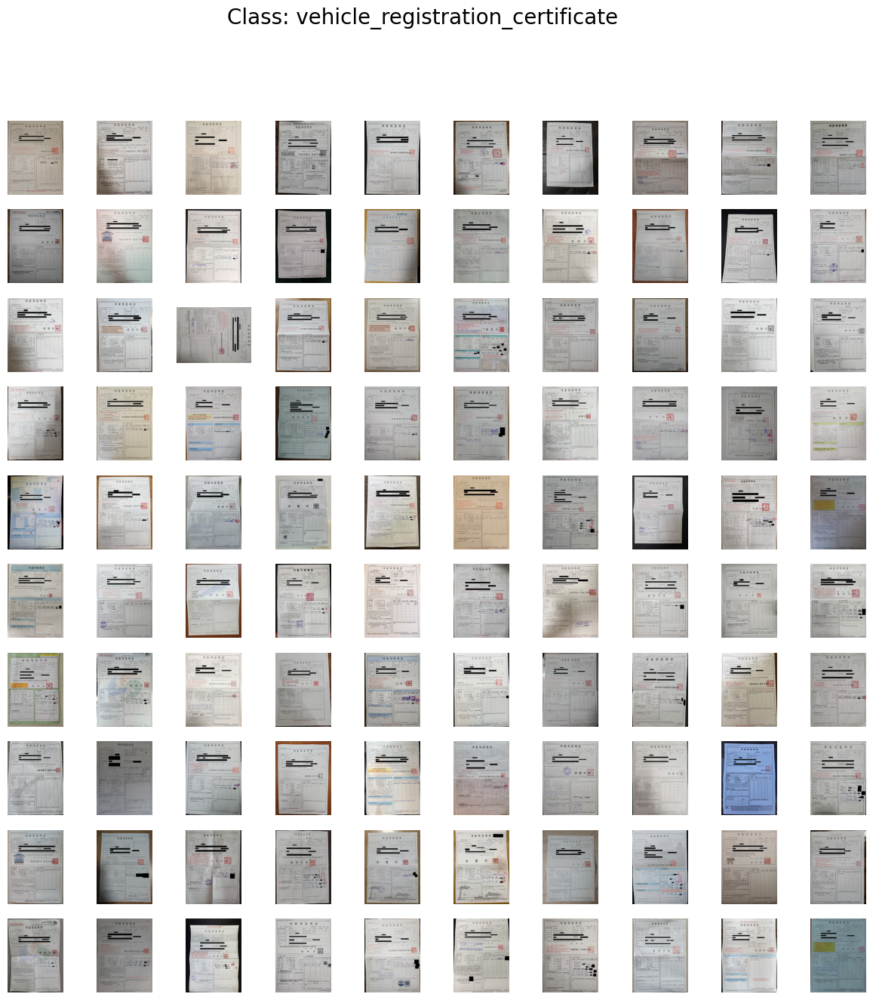

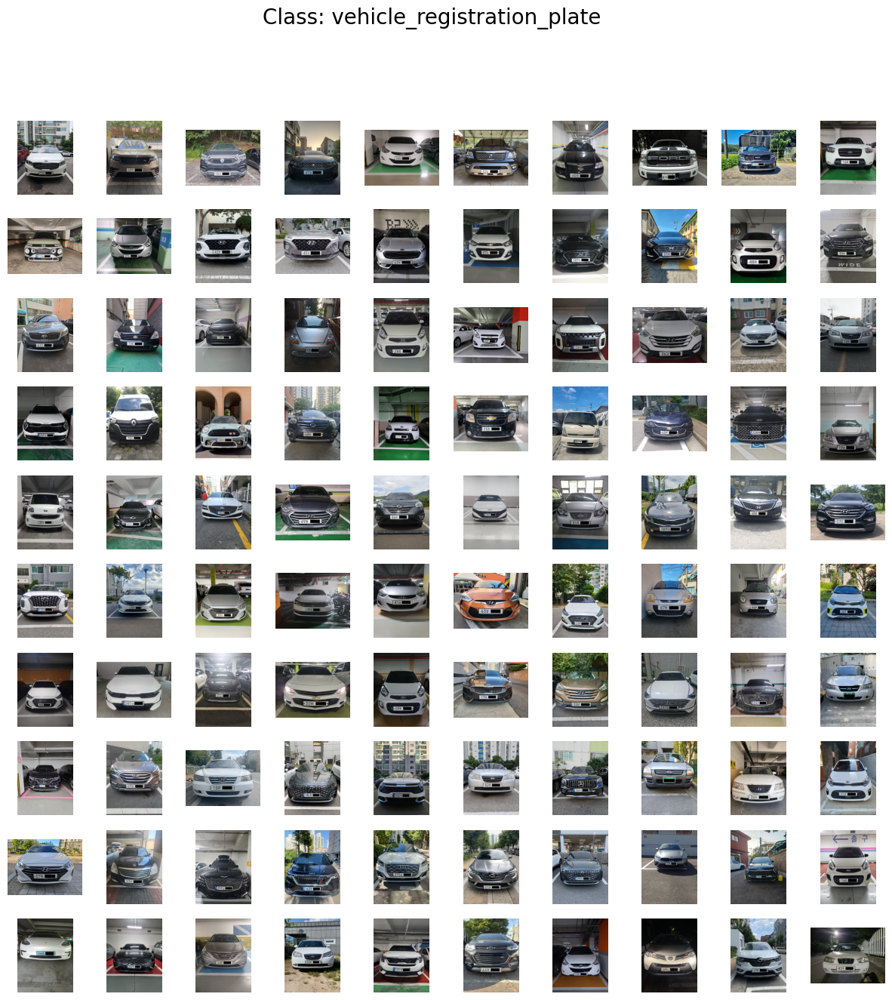

In [23]:
classes = meta_df['class_name'].unique()
num_images_per_class = 100
images_per_row = 10

for class_id in meta_df['target'].unique():
    class_name = meta_df[meta_df['target'] == class_id]['class_name'].values[0]
    class_images = train_df[train_df['target'] == class_id]['ID'].values[:num_images_per_class]
    
    fig, axes = plt.subplots(images_per_row, images_per_row, figsize=(15, 15))
    fig.suptitle(f'Class: {class_name}', fontsize=20)
    
    for idx, img_id in enumerate(class_images):
        img_path = os.path.join(f"{data_path}/train", img_id)
        try:
            img = cv2.imread(img_path)
            ax = axes[idx // images_per_row, idx % images_per_row]
            ax.imshow(img)
            ax.axis('off')
        except FileNotFoundError:
            continue 
    
    plt.show()